# 제품 이상여부 판별 프로젝트


## 1. 데이터 불러오기


### 필수 라이브러리


In [1]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

In [2]:
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'retina' ## 그림 더 선명하게

In [3]:
import os
from pprint import pprint

import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    f1_score,
    precision_score,
    recall_score,
)
from sklearn.model_selection import train_test_split
from tqdm import tqdm

In [4]:
import random

In [5]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
seed_everything(110) # Seed 고정

RANDOM_STATE=110

In [6]:
# col 생략 없이 출력
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 50)

In [7]:
def get_clf_eval(y_test, y_pred=None):
    confusion = confusion_matrix(y_test, y_pred, labels=[True, False])
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, labels=[True, False])
    recall = recall_score(y_test, y_pred)
    F1 = f1_score(y_test, y_pred, labels=[True, False])
    roc_auc = roc_auc_score(y_test, y_pred, labels=[True, False])
    print("오차행렬:\n", confusion)
    print("\n정확도: {:.4f}".format(accuracy))
    print("정밀도: {:.4f}".format(precision))
    print("재현율: {:.4f}".format(recall))
    print("F1: {:.4f}".format(F1))
    print(classification_report(y_test, y_pred, labels=[True, False]))
    print("ROC AUC Score: {}".format(roc_auc))

### 데이터 읽어오기


In [8]:
train_data = pd.read_csv('data/train.csv')

In [9]:
test = pd.read_csv('data/test.csv')
submission = pd.read_csv('submission.csv')

In [10]:
def pre(data):
    data['GMES_ORIGIN_INSP_JUDGE_CODE Collect Result_AutoClave']=data['GMES_ORIGIN_INSP_JUDGE_CODE Collect Result_AutoClave'].fillna('NO')
    data['GMES_ORIGIN_INSP_JUDGE_CODE Judge Value_AutoClave']=data['GMES_ORIGIN_INSP_JUDGE_CODE Judge Value_AutoClave'].fillna('NO')
    data['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].replace({'OK': np.nan}, inplace=True)
    data['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1'].replace({'OK': np.nan}, inplace=True)
    data['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill2'].replace({'OK': np.nan}, inplace=True)

    data['HEAD NORMAL COORDINATE X AXIS(Stage1) Judge Value_Dam'].replace({'OK': np.nan}, inplace=True)
    data['HEAD NORMAL COORDINATE X AXIS(Stage1) Judge Value_Fill1'].replace({'OK': np.nan}, inplace=True)
    data['HEAD NORMAL COORDINATE X AXIS(Stage1) Judge Value_Fill2'].replace({'OK': np.nan}, inplace=True)

    data.dropna(axis=1, how='all', inplace=True)

    # THICKNESS 1 Collect Result_Dam 값이 0이 아닌 값들을 식별
    mask = data['THICKNESS 1 Collect Result_Dam'] != 0

    # 밀린 열의 시작점과 끝점 정의
    start_cols = 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_'
    end_cols = 'WorkMode Collect Result_'  # 밀림이 발생한 마지막 열까지의 이름을 넣어야 합니다.

    for type in ['Dam', 'Fill1', 'Fill2']:
        start_col=start_cols+type
        end_col=end_cols+type
        # 밀린 열의 인덱스를 찾습니다.
        start_idx = data.columns.get_loc(start_col)
        end_idx = data.columns.get_loc(end_col) + 1  # 마지막 열 포함

        # 비정상적인 행들에서 밀린 열들만 선택하여 앞으로 이동
        shifted_part = data.loc[mask, data.columns[start_idx:end_idx]].shift(axis=1, periods=-1)

        # 이동된 값을 원래 데이터프레임에 반영
        data.loc[mask, data.columns[start_idx:end_idx]] = shifted_part
        
    data['WorkMode Collect Result_Dam'].fillna(7, inplace=True)
    data['WorkMode Collect Result_Fill1'].fillna(7, inplace=True)
    data['WorkMode Collect Result_Fill2'].fillna(0, inplace=True)

    data['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'] = data['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype('float64')
    data['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1'] = data['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1'].astype('float64')
    data['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill2'] = data['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill2'].astype('float64')

    data.dropna(axis=1, how='all', inplace=True)

    return data

train_data=pre(train_data)
test=pre(test)

C:\Users\horri\AppData\Local\Temp\ipykernel_32004\1481887889.py:32: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ 0.     0.012  0.    ...  0.    -0.019  0.   ]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data.loc[mask, data.columns[start_idx:end_idx]] = shifted_part
C:\Users\horri\AppData\Local\Temp\ipykernel_32004\1481887889.py:32: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[114.612 114.612  85.    ...  85.    114.612  85.   ]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data.loc[mask, data.columns[start_idx:end_idx]] = shifted_part
C:\Users\horri\AppData\Local\Temp\ipykernel_32004\1481887889.py:32: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[-0.054  0.     0.    ...  0.     

In [11]:
# train_data=train_data.loc[:,train_data.nunique()>1]

# test_data=test_data.loc[:,test_data.nunique()>1]

In [12]:
# 세 변수의 값이 같은지 확인하는 열 추가
condition = (test['Production Qty Collect Result_Dam'] == test['Production Qty Collect Result_Fill1']) & (test['Production Qty Collect Result_Dam'] == test['Production Qty Collect Result_Fill2'])

index1 =test[condition==False].index
index1

Index([   64,   562,  1460,  1530,  1892,  2505,  2710,  3457,  3682,  3732,
        4928,  4932,  6092,  7001,  7287,  7666,  7836,  8253,  8898, 10989,
       12439, 12585, 12844, 14756, 15180, 15406, 15811, 15964],
      dtype='int64')

In [13]:
# 특정 값들을 가진 행만 추출
values_to_extract = [4.3, 4.4, 4.5, 4.8, 14.8]
index2 = test[test['DISCHARGED TIME OF RESIN(Stage2) Collect Result_Fill1'].isin(values_to_extract)].index

In [14]:
index3 = test[test['Workorder_Dam']=='4C1XH474-1'].index

### 인코딩

In [ ]:
from sklearn.preprocessing import LabelEncoder
train_data['target']=train_data['target'].map({'Normal':0, 'AbNormal':1})

label_encoders = {}
for column in train_data.select_dtypes(include=['object']).columns:
    label_encoders[column] = LabelEncoder()
    train_data[column] = label_encoders[column].fit_transform(train_data[column])

### 증강


### 모델링

In [15]:
from sklearn.preprocessing import StandardScaler

def scale(data, scaler, type='train'):
    # 데이터 프레임 생성
    scaled_data = data.copy()

    for col in data.columns[data.columns.str.contains('PalletID')|data.columns.str.contains('Qty')]:
        data[col]=data[col].astype(str)
        scaled_data[col]=scaled_data[col].astype(str)

    # 실수형 변수만 선택
    numeric_features = data.select_dtypes(include=['float64', 'int64'])

    # 스케일러 적용
    if type == 'train':
        scaled_numeric_features = scaler.fit_transform(numeric_features)
    else:
        scaled_numeric_features = scaler.transform(numeric_features)

    # 스케일링된 데이터를 데이터프레임으로 변환 (원본 인덱스와 동일하게 설정)
    scaled_numeric_df = pd.DataFrame(scaled_numeric_features, index=data.index, columns=numeric_features.columns)

    # 스케일링된 데이터프레임을 원본 데이터에 업데이트
    scaled_data.update(scaled_numeric_df)
    
    if type == 'train':
        return scaled_data, scaler
    else:
        return scaled_data

train_data, scaler=scale(train_data, StandardScaler(), 'train')
test=scale(test, scaler,'test')

In [16]:
RANDOM_STATE=110

In [17]:
# X_train, y_train = train_data.drop('target', axis=1), train_data['target']
X_train, X_test, y_train, y_test = train_test_split(train_data.drop('target', axis=1), train_data['target'], test_size=0.2, random_state=RANDOM_STATE, stratify=train_data['target'])
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=RANDOM_STATE, stratify=y_train)

In [574]:
from catboost import CatBoostClassifier, Pool

col=X_train.columns[(X_train.columns.str.contains('Auto'))|(X_train.columns.str.contains('Fill2'))|(X_train.columns.str.contains('Fill1'))]
# col=X_train.columns
categorical_features_indices = list(X_train[col].select_dtypes(include=['object']).columns)

# y_resampled의 클래스 비율 계산
class_counts = y_train.value_counts()
total_samples = len(y_train)

# 각 클래스의 가중치 계산 (클래스 수가 많을 경우 대비하여 보통의 방식을 사용)
class_weights = {cls: total_samples / (len(class_counts) * count) for cls, count in class_counts.items()}

class_weights['AbNormal'] = class_weights['AbNormal']/1.5

# CatBoost 모델 정의
model = CatBoostClassifier(
    iterations=110,
    learning_rate=0.1,
    depth=6,
    l2_leaf_reg=3,
    random_strength=1,
    bagging_temperature=0.5,
    loss_function='Logloss',
    eval_metric='F1',
    class_weights=class_weights,  # 계산한 클래스 가중치 적용
    cat_features=categorical_features_indices,
    random_seed=RANDOM_STATE,
    verbose=100
)

# 모델 학습
model.fit(X_train[col], y_train, eval_set=(X_val[col], y_val), use_best_model=True)

0:	learn: 0.4010751	test: 0.4116060	best: 0.4116060 (0)	total: 60.7ms	remaining: 6.61s
100:	learn: 0.5474081	test: 0.4425801	best: 0.4465348 (96)	total: 7.2s	remaining: 641ms
109:	learn: 0.5602575	test: 0.4320686	best: 0.4465348 (96)	total: 8.13s	remaining: 0us

bestTest = 0.4465347994
bestIteration = 96

Shrink model to first 97 iterations.


In [587]:
# 예측 확률 계산
y_pred_proba = model.predict_proba(X_test[col])[:, 1]

# 임계값 조정
threshold = 0.56
y_pred = ['AbNormal' if i > threshold else 'Normal' for i in y_pred_proba]

In [588]:
f1_score(y_val, model.predict(X_val[col]), pos_label='AbNormal')

0.19696048632218846

In [589]:
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
cm=confusion_matrix(y_test, y_pred)
print('혼동행렬\n', cm)
p_score=precision_score(y_test, y_pred, pos_label='AbNormal')
r_score=recall_score(y_test, y_pred, pos_label='AbNormal')
f_score=f1_score(y_test, y_pred, pos_label='AbNormal')
print('precision: ', p_score)
print('recall: ', r_score)
print('f1 score: ', f_score)

print('결과\n', classification_report(y_test, y_pred))

혼동행렬
 [[  95  375]
 [ 412 7220]]
precision:  0.1873767258382643
recall:  0.20212765957446807
f1 score:  0.19447287615148415
결과
               precision    recall  f1-score   support

    AbNormal       0.19      0.20      0.19       470
      Normal       0.95      0.95      0.95      7632

    accuracy                           0.90      8102
   macro avg       0.57      0.57      0.57      8102
weighted avg       0.91      0.90      0.90      8102



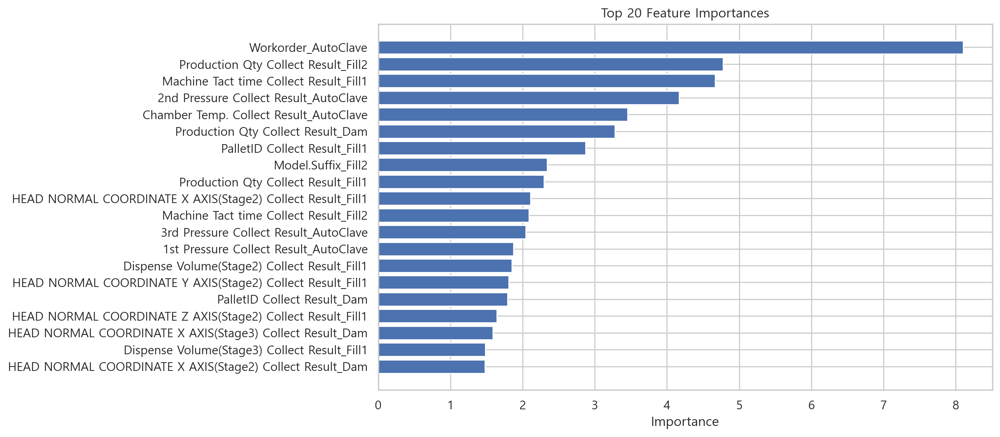

In [510]:
import matplotlib.pyplot as plt

# 변수 중요도 추출
feature_importances = model.get_feature_importance()

# 중요도 상위 20개 변수만 추출
top_features = sorted(zip(feature_importances, col), reverse=True)[:20]

# 변수명과 중요도를 각각 리스트로 추출
top_importances = [imp for imp, _ in top_features]
top_names = [name for _, name in top_features]

# 시각화
plt.figure(figsize=(10, 6))
plt.barh(top_names, top_importances)
plt.xlabel('Importance')
plt.title('Top 20 Feature Importances')
plt.gca().invert_yaxis()  # 중요도 순으로 내림차순 정렬
plt.show()

In [18]:
train_data2=train_data[(train_data['target']=='Normal')&(train_data['Workorder_Dam'].isin(train_data['Workorder_Dam'].unique()[(train_data['Workorder_Dam'].value_counts()>1)]))]

In [19]:
# X_train, y_train = train_data.drop('target', axis=1), train_data['target']
X_train, X_test, y_train, y_test = train_test_split(train_data2.drop('Workorder_Dam', axis=1), train_data2['Workorder_Dam'], test_size=0.2, random_state=RANDOM_STATE)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=RANDOM_STATE)

In [21]:
from catboost import CatBoostClassifier, Pool

# col=X_train.columns[(X_train.columns.str.contains('Auto'))|(X_train.columns.str.contains('Fill2'))|(X_train.columns.str.contains('Fill1'))]
col=X_train.columns
categorical_features_indices = list(X_train[col].select_dtypes(include=['object']).columns)

# y_resampled의 클래스 비율 계산
class_counts = y_train.value_counts()
total_samples = len(y_train)

# 각 클래스의 가중치 계산 (클래스 수가 많을 경우 대비하여 보통의 방식을 사용)
class_weights = {cls: total_samples / (len(class_counts) * count) for cls, count in class_counts.items()}

# CatBoost 모델 정의
model = CatBoostClassifier(
    iterations=1,
    learning_rate=0.1,
    depth=6,
    l2_leaf_reg=3,
    random_strength=1,
    bagging_temperature=0.5,
    loss_function='MultiClass',
    eval_metric='Accuracy',
    class_weights=class_weights,  # 계산한 클래스 가중치 적용
    cat_features=categorical_features_indices,
    random_seed=RANDOM_STATE,
    verbose=100
)

# 학습 데이터셋에 존재하는 클래스 레이블만 남김
valid_labels = y_train.unique()
X_val_filtered = X_val[y_val.isin(valid_labels)]
y_val_filtered = y_val[y_val.isin(valid_labels)]

# 모델 학습
model.fit(X_train[col], y_train, eval_set=(X_val_filtered[col], y_val_filtered), use_best_model=True)

In [608]:
RANDOM_STATE=200

In [444]:
from catboost import CatBoostClassifier
from sklearn.metrics import f1_score
import numpy as np

# y_resampled의 클래스 비율 계산
class_counts = y_train.value_counts()
total_samples = len(y_train)

# 각 클래스의 가중치 계산 (클래스 수가 많을 경우 대비하여 보통의 방식을 사용)
class_weights = {cls: total_samples / (len(class_counts) * count) for cls, count in class_counts.items()}

class_weights['AbNormal'] = class_weights['AbNormal']/1.7


# 변수 집합 정의
col_set_1 = X_train.columns[(X_train.columns.str.contains('Auto'))]
col_set_2 = X_train.columns[(X_train.columns.str.contains('Dam'))]
col_set_3 = X_train.columns[(X_train.columns.str.contains('Fill1'))]
col_set_4 = X_train.columns[(X_train.columns.str.contains('Fill2'))]

# 모델 학습
def train_catboost(X_train, y_train, X_val, y_val, columns):
    categorical_features_indices = list(X_train[columns].select_dtypes(include=['object']).columns)
    model = CatBoostClassifier(
        iterations=110,
        learning_rate=0.1,
        depth=6,
        l2_leaf_reg=3,
        random_strength=1,
        bagging_temperature=0.5,
        loss_function='Logloss',
        eval_metric='F1',
        class_weights=class_weights,
        cat_features=categorical_features_indices,
        random_seed=RANDOM_STATE,
        verbose=100
    )
    model.fit(X_train[columns], y_train, eval_set=(X_val[columns], y_val), use_best_model=True)
    return model

model_1 = train_catboost(X_train, y_train, X_val, y_val, col_set_1)
model_2 = train_catboost(X_train, y_train, X_val, y_val, col_set_2)
model_3 = train_catboost(X_train, y_train, X_val, y_val, col_set_3)
model_4 = train_catboost(X_train, y_train, X_val, y_val, col_set_4)

0:	learn: 0.0441201	test: 0.0414317	best: 0.0414317 (0)	total: 26.3ms	remaining: 2.87s
100:	learn: 0.4130486	test: 0.3696059	best: 0.3914729 (86)	total: 5.89s	remaining: 525ms
109:	learn: 0.4256346	test: 0.3744711	best: 0.3914729 (86)	total: 6.31s	remaining: 0us

bestTest = 0.3914728647
bestIteration = 86

Shrink model to first 87 iterations.
0:	learn: 0.0873550	test: 0.0909309	best: 0.0909309 (0)	total: 43.9ms	remaining: 4.78s
100:	learn: 0.4639709	test: 0.3836558	best: 0.3933214 (74)	total: 5.6s	remaining: 499ms
109:	learn: 0.4756805	test: 0.3951908	best: 0.3954332 (108)	total: 6.11s	remaining: 0us

bestTest = 0.3954332197
bestIteration = 108

Shrink model to first 109 iterations.
0:	learn: 0.3048527	test: 0.3057287	best: 0.3057287 (0)	total: 54.2ms	remaining: 5.91s
100:	learn: 0.4661977	test: 0.3754594	best: 0.3835222 (79)	total: 5.98s	remaining: 533ms
109:	learn: 0.4883786	test: 0.3772885	best: 0.3835222 (79)	total: 6.45s	remaining: 0us

bestTest = 0.3835222396
bestIteration = 79



In [473]:
# 각 모델의 예측 확률을 얻음
probs_1 = model_1.predict_proba(X_test[col_set_1])[:, 1]  # 'AbNormal' 클래스에 대한 확률
probs_2 = model_2.predict_proba(X_test[col_set_2])[:, 1]
probs_3 = model_3.predict_proba(X_test[col_set_3])[:, 1]
probs_4 = model_4.predict_proba(X_test[col_set_4])[:, 1]

# 각 모델에 대한 임계값 설정
threshold_1 = 0.3
threshold_2 = 0.9
threshold_3 = 0.6
threshold_4 = 0.5

# 각 모델의 예측 결과를 배열로 만듭니다.
final_preds = []
for i in range(len(X_test)):
    preds = []
    preds.append('AbNormal' if probs_1[i] >= threshold_1 else 'Normal')
    preds.append('AbNormal' if probs_2[i] >= threshold_2 else 'Normal')
    preds.append('AbNormal' if probs_3[i] >= threshold_3 else 'Normal')
    preds.append('AbNormal' if probs_4[i] >= threshold_4 else 'Normal')
    final_preds.append(preds)

final_preds = np.array(final_preds)

# "AbNormal" 개수에 따라 투표 결과 결정
def abnormal_voting(predictions, abnormal_threshold=1):
    results = []
    for i in range(predictions.shape[0]):
        abnormal_count = np.sum(predictions[i] == 'AbNormal')
        
        # "AbNormal" 클래스가 임계값 이상 예측되었으면 "AbNormal"로 예측
        if abnormal_count >= abnormal_threshold:
            results.append('AbNormal')
        else:
            # 그렇지 않으면 "Normal"로 예측
            results.append('Normal')
    return np.array(results)

# 예를 들어, "AbNormal"이 2번 이상 예측된 경우 "AbNormal"로 결정
y_pred = abnormal_voting(final_preds, abnormal_threshold=2)

# 최종 예측 성능 평가
f1 = f1_score(y_test, y_pred, pos_label='AbNormal')
print(f'Final F1 Score: {f1}')

Final F1 Score: 0.2008298755186722


In [464]:
cm=confusion_matrix(y_test, y_pred)
print('혼동행렬\n', cm)
p_score=precision_score(y_test, y_pred, pos_label='AbNormal')
r_score=recall_score(y_test, y_pred, pos_label='AbNormal')
f_score=f1_score(y_test, y_pred, pos_label='AbNormal')
print('precision: ', p_score)
print('recall: ', r_score)
print('f1 score: ', f_score)

print('결과\n', classification_report(y_test, y_pred))

혼동행렬
 [[ 122  348]
 [ 624 7008]]
precision:  0.16353887399463807
recall:  0.25957446808510637
f1 score:  0.20065789473684212
결과
               precision    recall  f1-score   support

    AbNormal       0.16      0.26      0.20       470
      Normal       0.95      0.92      0.94      7632

    accuracy                           0.88      8102
   macro avg       0.56      0.59      0.57      8102
weighted avg       0.91      0.88      0.89      8102



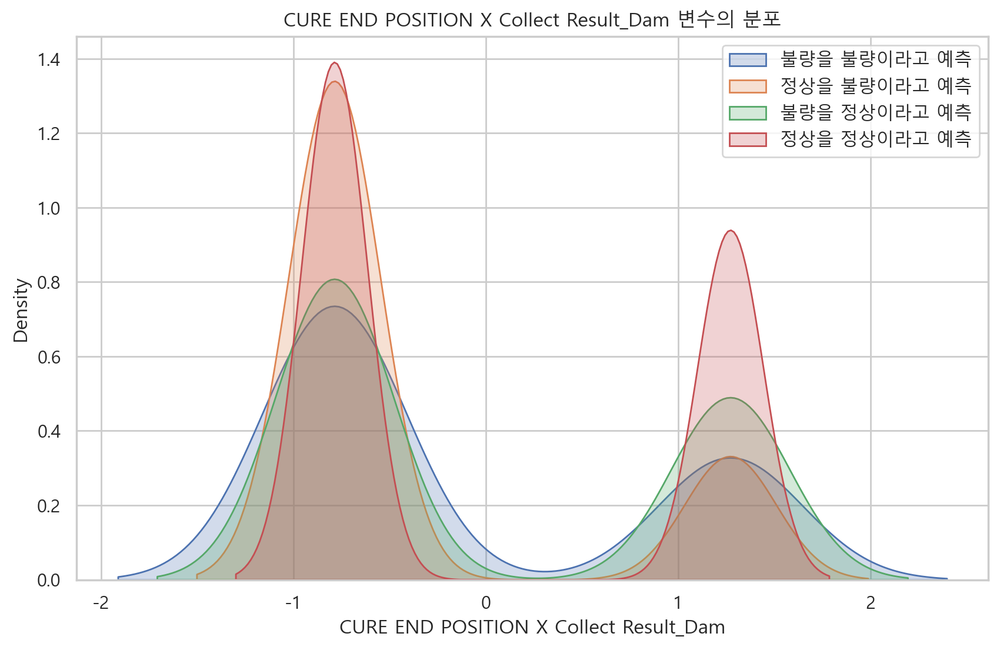

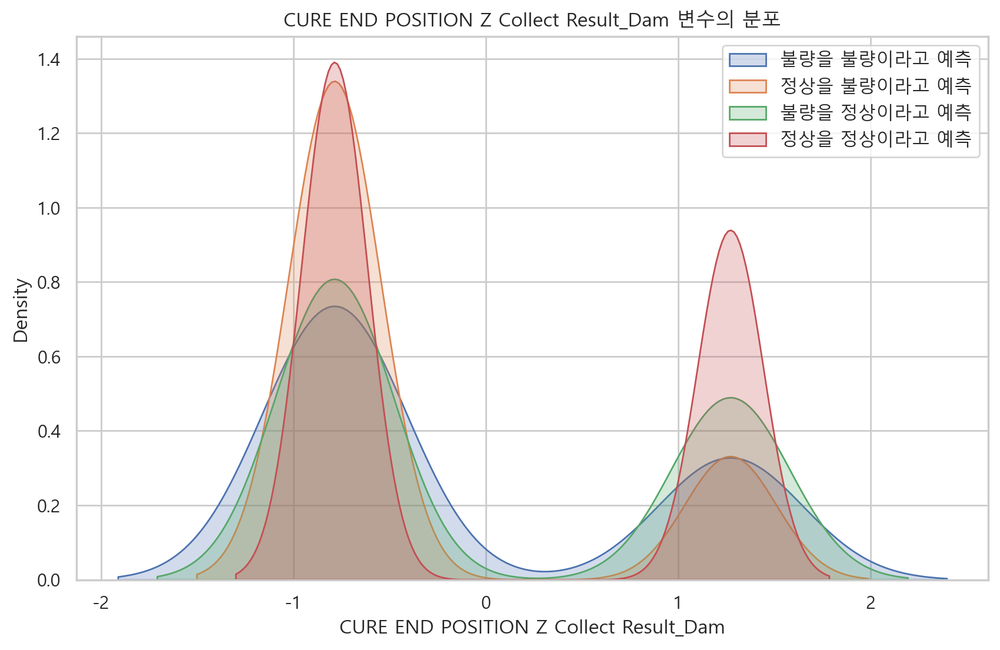

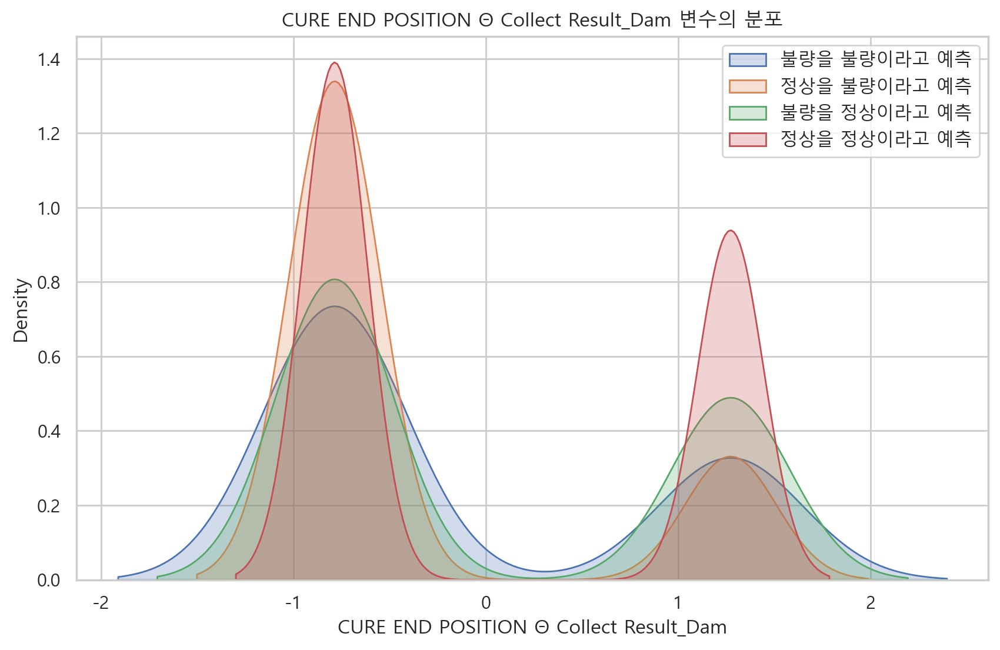

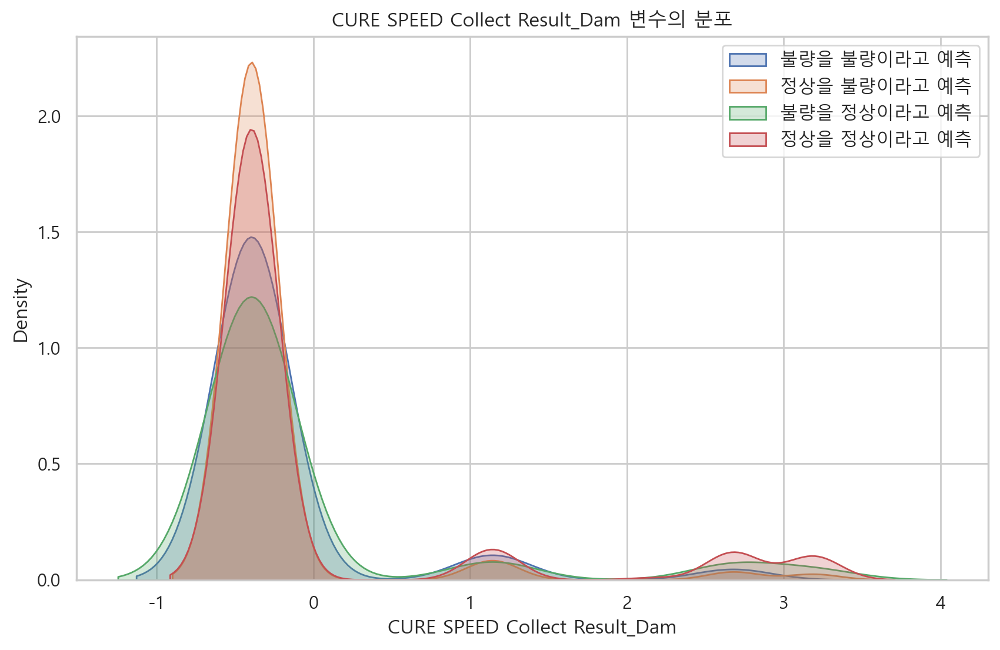

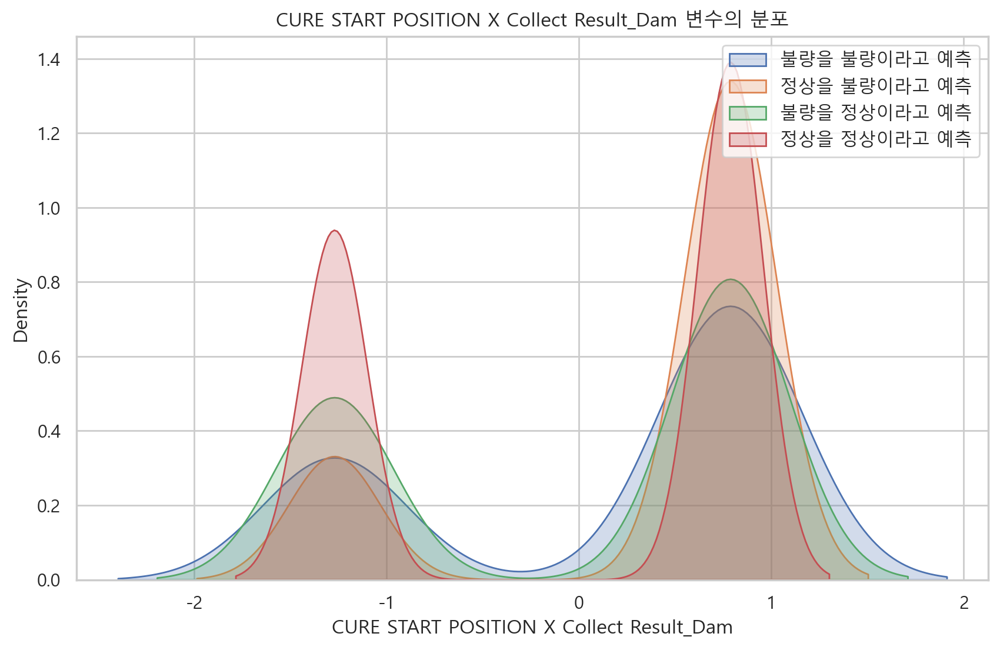

...

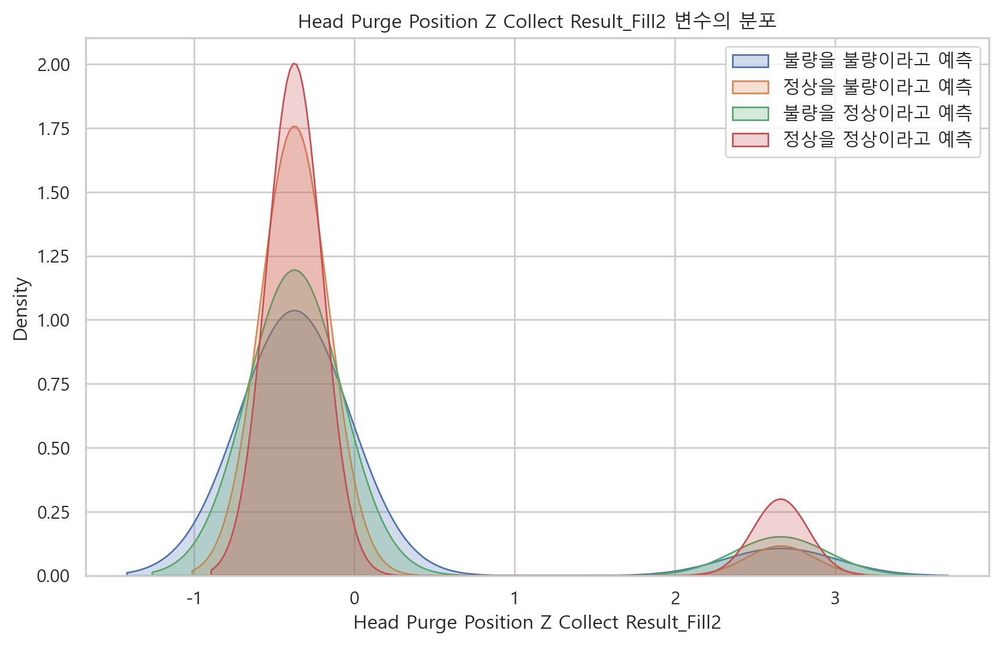

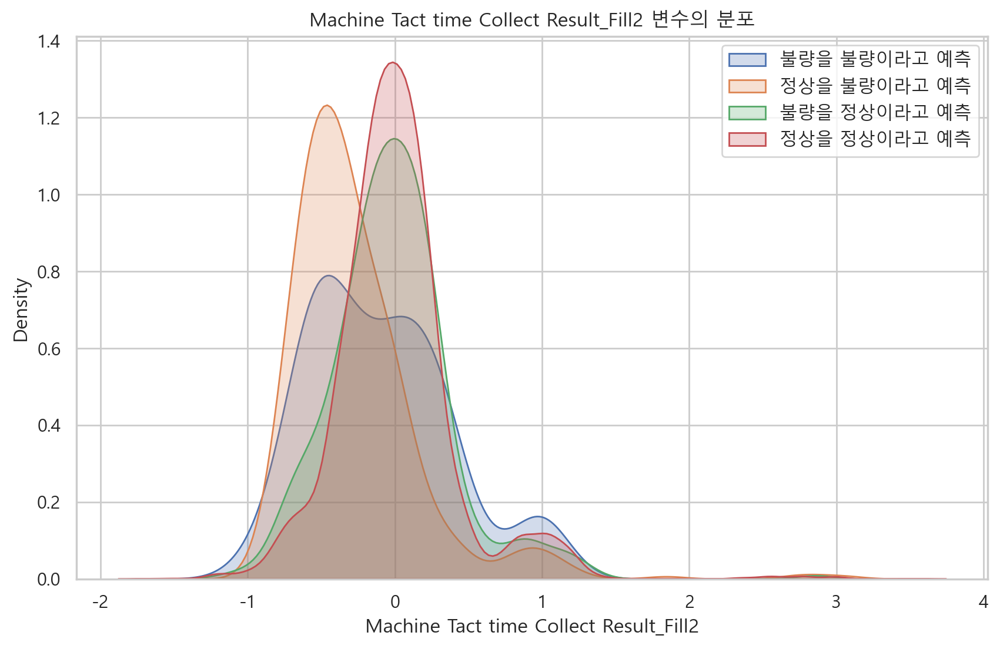

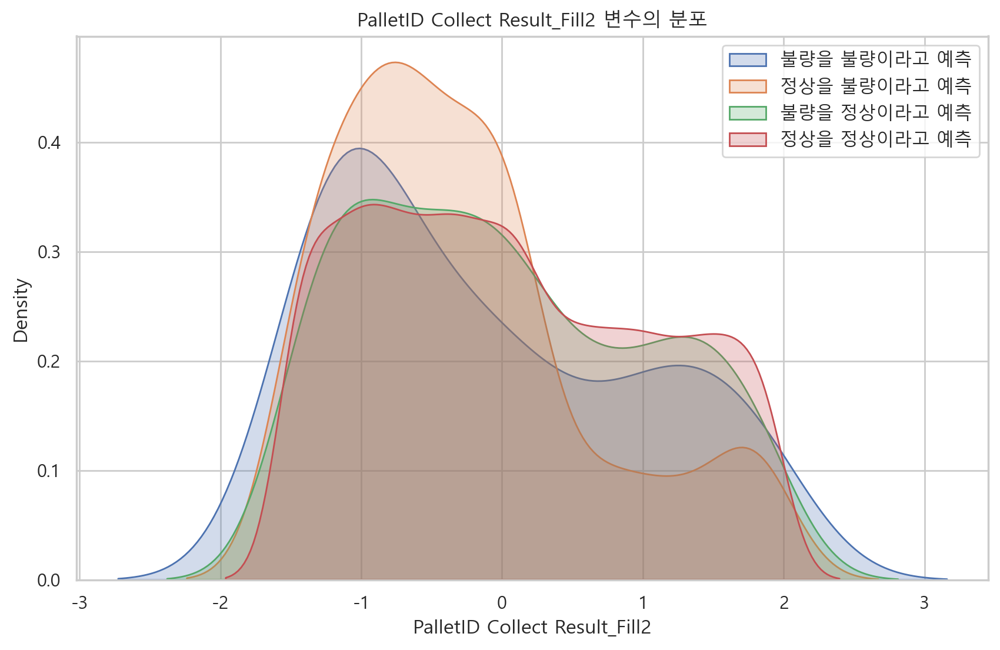

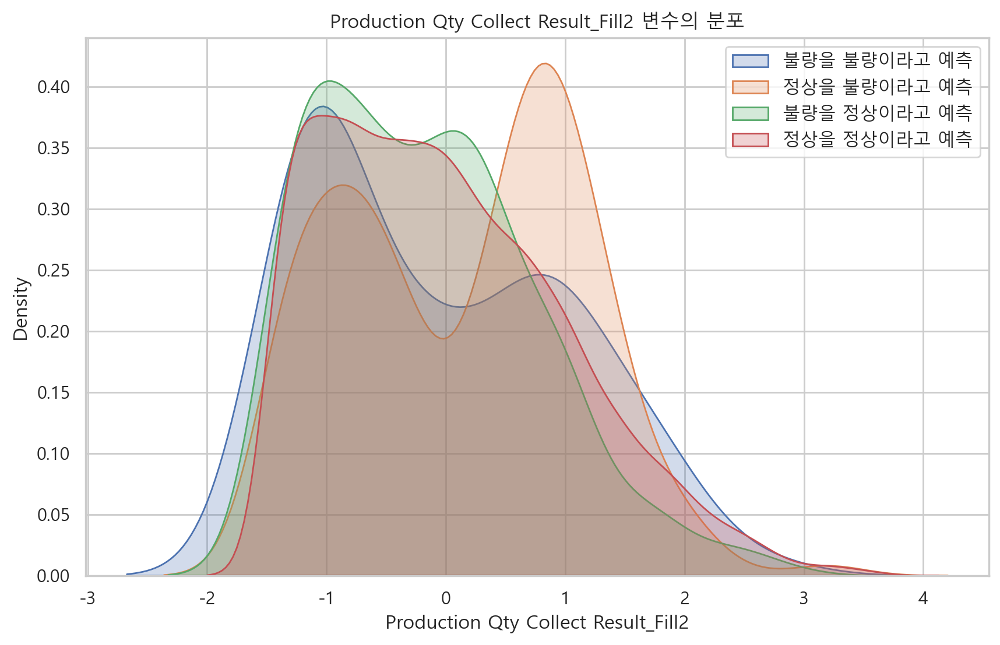

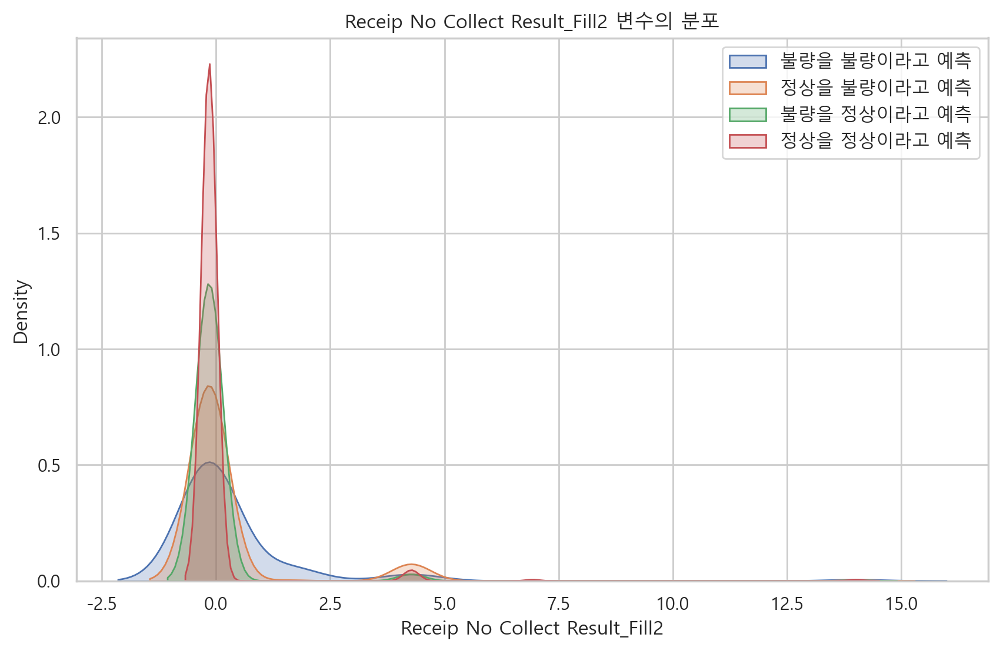

In [272]:
import seaborn as sns
import matplotlib.pyplot as plt

# 한글 폰트 설정
plt.rc('font', family='Malgun Gothic')  # 또는 'AppleGothic' (Mac의 경우)
plt.rc('axes', unicode_minus=False)

# 수치형 변수만 선택
numeric_columns = X_test.loc[:, X_test.nunique()>1].select_dtypes(include=['float64', 'int64']).columns

# TP, FP, FN, TN에 해당하는 인덱스 추출
tp_indices = (y_test.values == 'AbNormal') & (np.array(y_pred) == 'AbNormal')
fp_indices = (y_test.values == 'Normal') & (np.array(y_pred) == 'AbNormal')
fn_indices = (y_test.values == 'AbNormal') & (np.array(y_pred) == 'Normal')
tn_indices = (y_test.values == 'Normal') & (np.array(y_pred) == 'Normal')

# 수치형 변수의 KDE 그래프
for col in numeric_columns:
    plt.figure(figsize=(10, 6))
    
    sns.kdeplot(X_test.loc[tp_indices, col], label='불량을 불량이라고 예측', fill=True)
    sns.kdeplot(X_test.loc[fp_indices, col], label='정상을 불량이라고 예측', fill=True)
    sns.kdeplot(X_test.loc[fn_indices, col], label='불량을 정상이라고 예측', fill=True)
    sns.kdeplot(X_test.loc[tn_indices, col], label='정상을 정상이라고 예측', fill=True)
    
    plt.title(f'{col} 변수의 분포')
    plt.legend()
    plt.show()

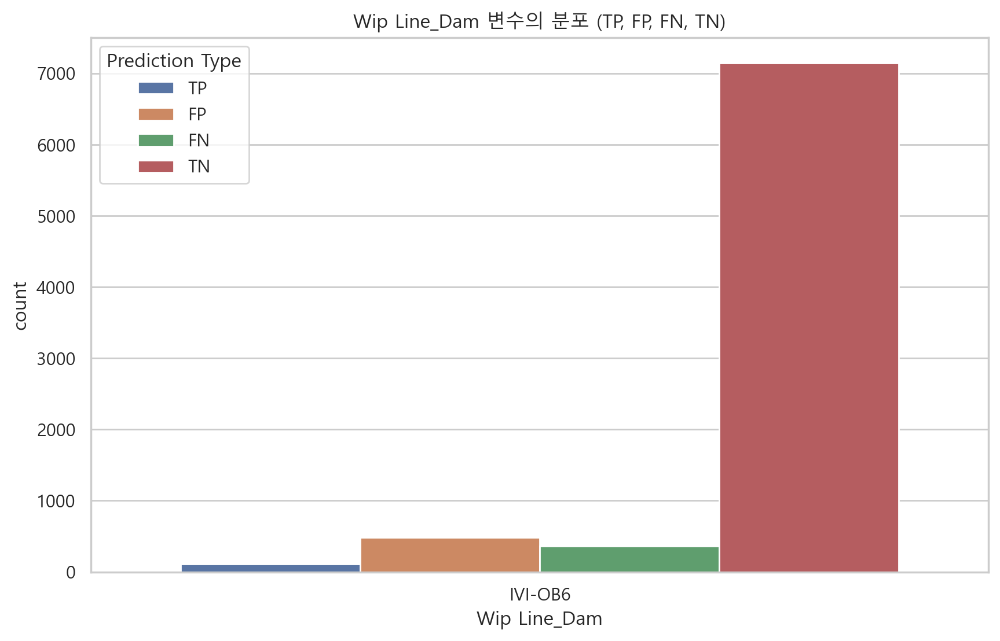

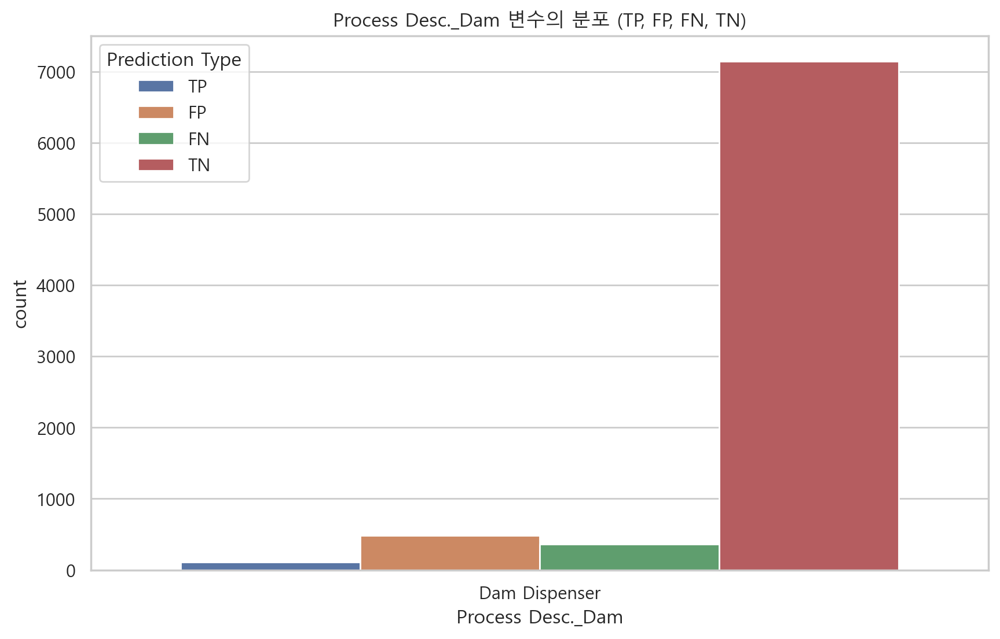

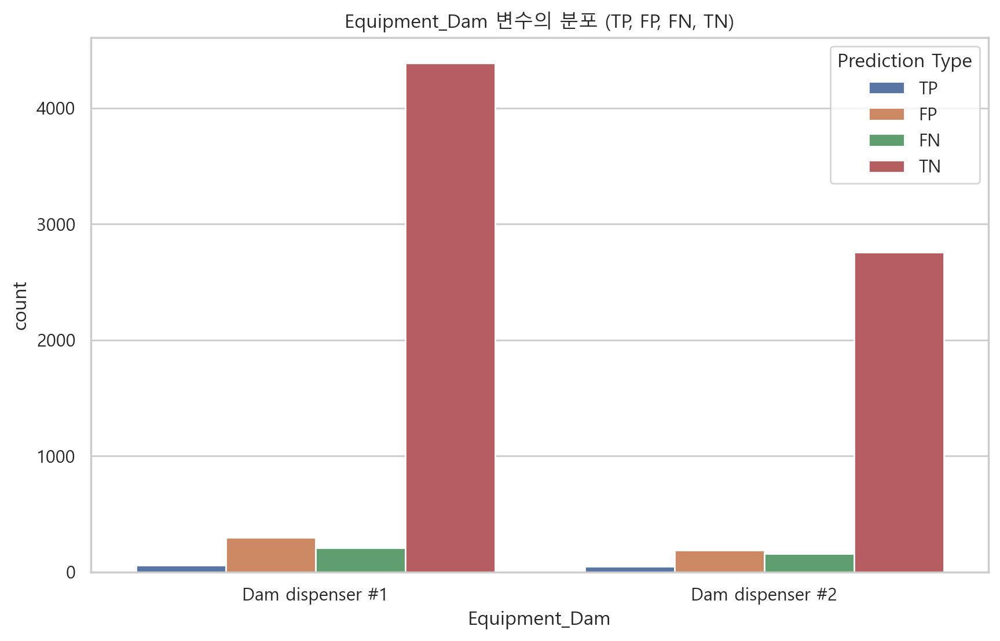

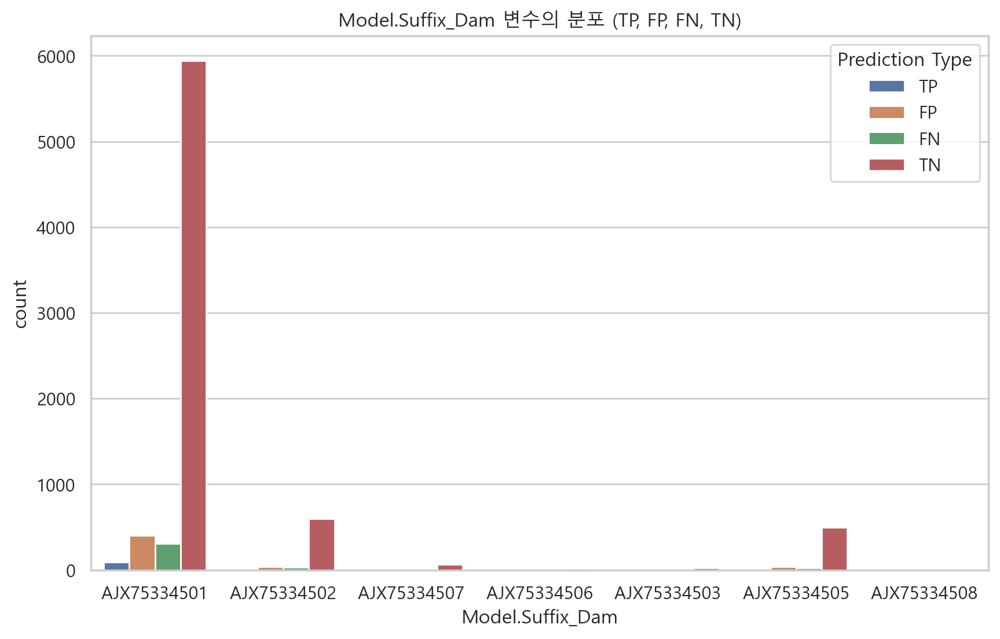

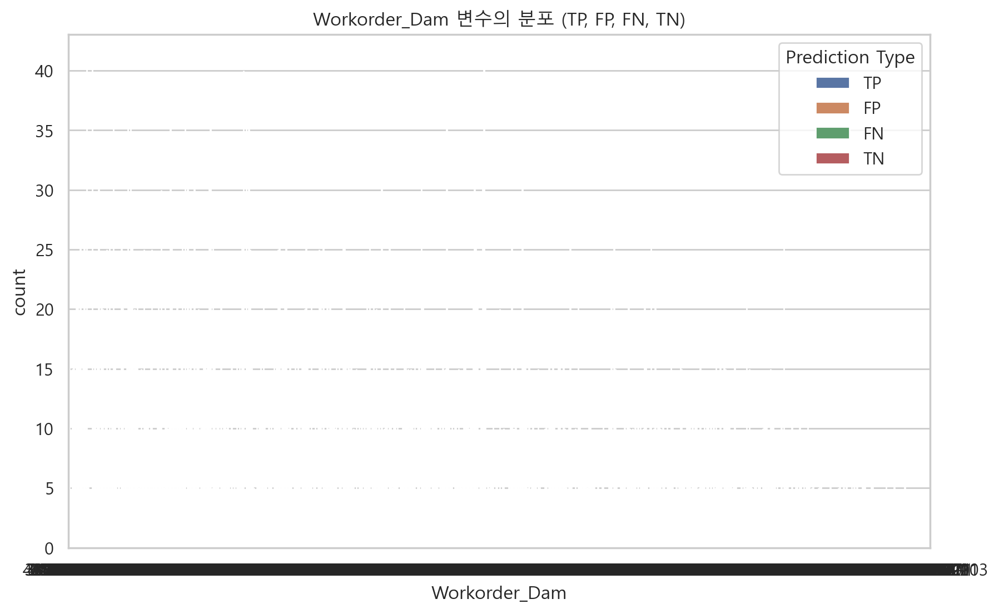

...

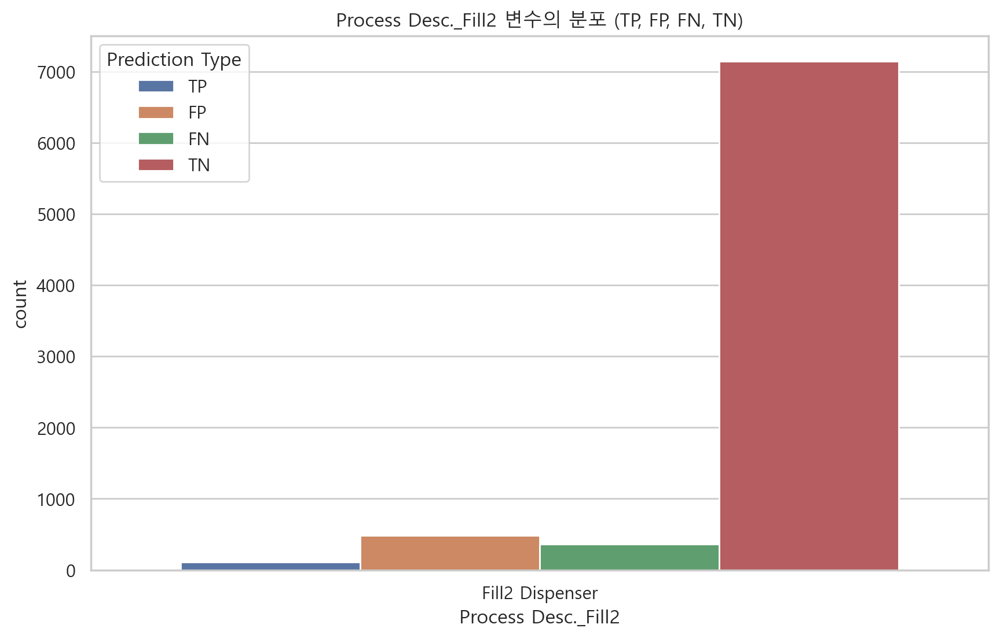

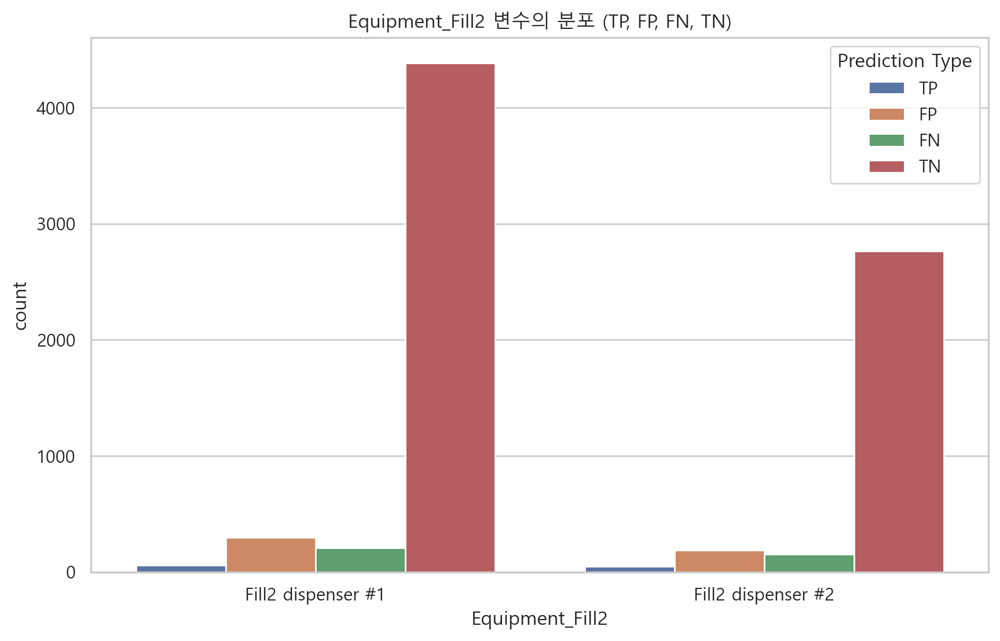

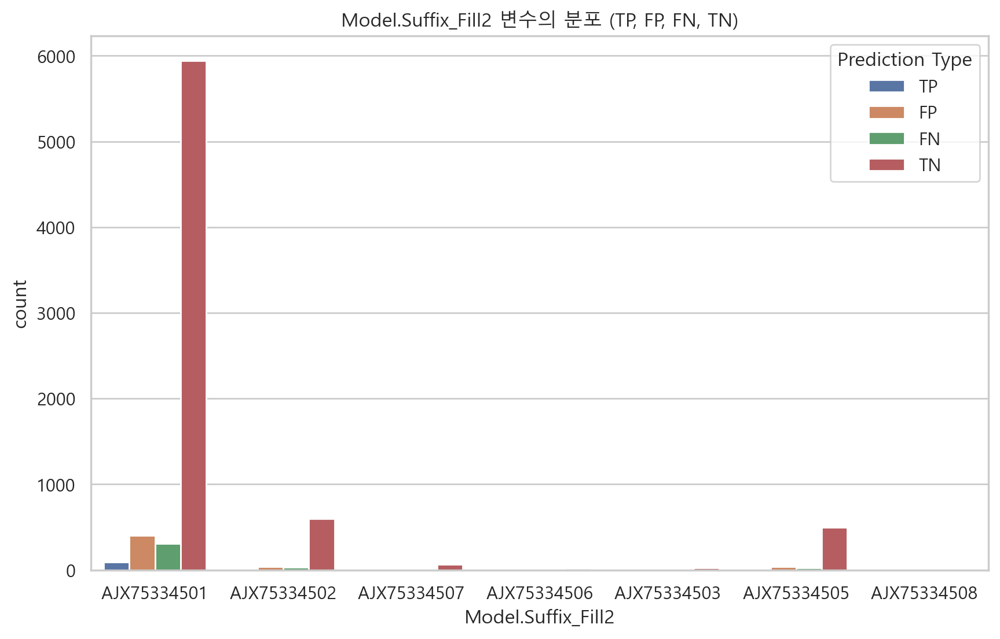

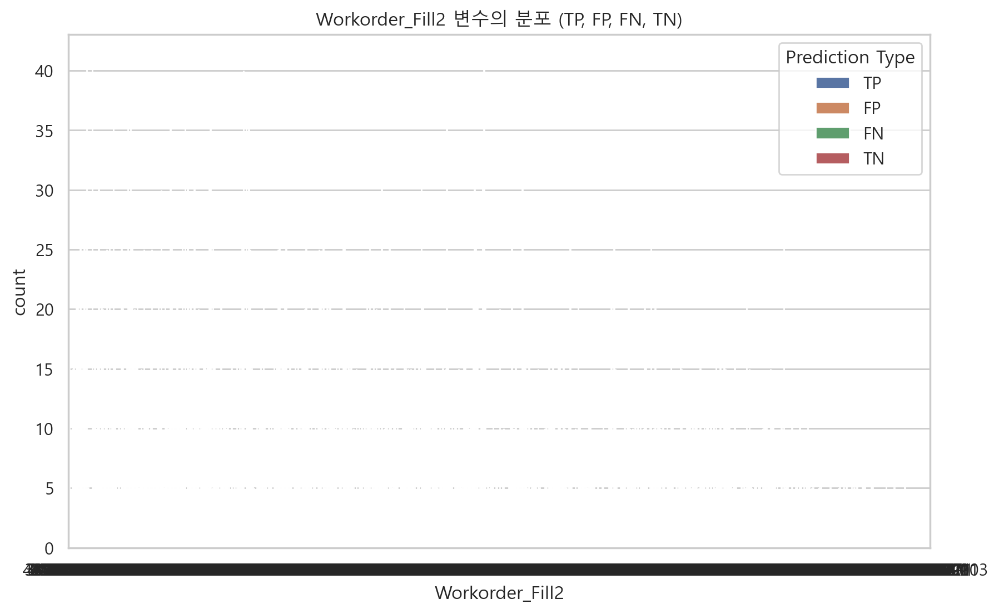

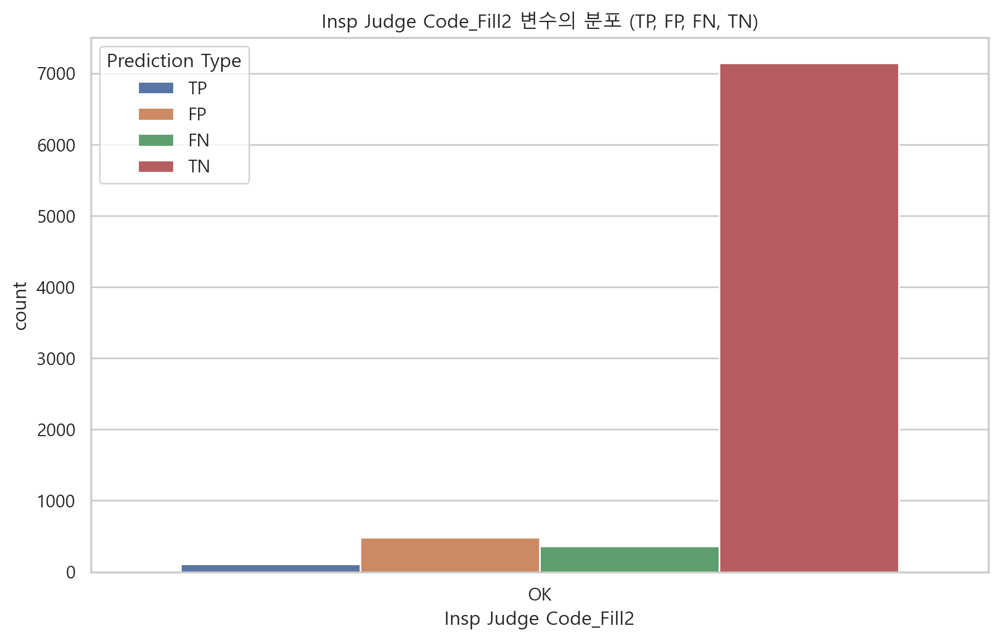

In [275]:
# 범주형 변수만 선택
categorical_columns = X_test.select_dtypes(include=['object']).columns

# 범주형 변수만 선택
categorical_columns = X_test.select_dtypes(include=['object']).columns

# 범주형 변수의 TP, FP, FN, TN 분포 시각화
for col in categorical_columns:
    plt.figure(figsize=(10, 6))

    # TP, FP, FN, TN에 대한 데이터프레임 생성
    df = pd.DataFrame({
        col: X_test[col],
        'pred_type': ['TP']*len(X_test[tp_indices]) + ['FP']*len(X_test[fp_indices]) + ['FN']*len(X_test[fn_indices]) + ['TN']*len(X_test[tn_indices]),
    })
    
    df = df[df['pred_type'] != '']
    
    # 각 카테고리별 분포 시각화
    sns.countplot(x=col, hue='pred_type', data=df, order=X_test[col].unique())
    
    plt.title(f'{col} 변수의 분포 (TP, FP, FN, TN)')
    plt.legend(title='Prediction Type')
    plt.show()

In [218]:
columns_with_new_values = []
for col in categorical_features_indices:
    if not test[col].isin(train_data[col].unique()).all():
        columns_with_new_values.append(col)

# 2. 해당 열들에 대해서만 'Unknown'으로 대체
for col in columns_with_new_values:
    unique_train_values = set(train_data[col].unique())
    test[col] = test[col].apply(lambda x: x if x in unique_train_values else 'Unknown')

In [219]:
# 예측 확률 계산
test_pred_proba = model.predict_proba(test.iloc[:,1:])[:, 1]

# 임계값 조정
threshold = 0.52
test_pred = ['AbNormal' if i > threshold else 'Normal' for i in test_pred_proba]

In [230]:
# 제출 데이터 읽어오기 (df_test는 전처리된 데이터가 저장됨)
df_sub = pd.read_csv("submission.csv")
df_sub["target"] = test_pred

In [231]:
df_sub.loc[index1, 'target'].value_counts()

target
AbNormal    21
Normal       7
Name: count, dtype: int64

In [232]:
df_sub.loc[index2, 'target'].value_counts()

target
Normal      45
AbNormal     8
Name: count, dtype: int64

In [233]:
df_sub.loc[index3, 'target'].value_counts()

target
Normal    20
Name: count, dtype: int64

In [234]:
df_sub['target'].value_counts()

target
Normal      16001
AbNormal     1360
Name: count, dtype: int64

In [235]:
df_sub.loc[index1, 'target'] = 'AbNormal'

# 제출 파일 저장
df_sub.to_csv("submission.csv", index=False)

In [ ]:
df_sub.target.value_counts()

In [121]:
xgb_params = {'learning_rate': 0.12491630383825054, 'n_estimators': 1000, 'max_depth': 7, 
              'min_child_weight': 1.4188916767259947, 'gamma': 0.8984320230798564,
              'subsample': 0.9572565799607672, 'colsample_bytree': 0.9791735882009905, 
              'reg_lambda': 0.073001866176346, 'reg_alpha': 0.59405659848461, 
              'scale_pos_weight': 5}

In [122]:
#!pip install xgboost

import xgboost as xgb
from xgboost import XGBClassifier
# 학습 진행
#model  = XGBClassifier(random_state = 42, learning_rate =0.1, n_estimators=200,
 #   max_depth=9, subsample=0.8,colsample_bytree=0.8,scale_pos_weight = 5)
model = XGBClassifier(random_state =42, **xgb_params)

In [123]:
model.fit(x_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9791735882009905, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0.8984320230798564,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.12491630383825054,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=1.4188916767259947, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=1000,
              n_jobs=None, num_parallel_tree=None, random_state=42, ...)

In [124]:
import pandas as pd
import numpy as np
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix,
    f1_score,
    precision_score,
    recall_score,roc_auc_score,
    confusion_matrix, classification_report
)
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

In [125]:
pred = model.predict(x_valid)
get_clf_eval(y_valid, pred)

오차행렬:
 [[7241  339]
 [ 144 7539]]

정확도: 0.9684
정밀도: 0.9805
재현율: 0.9553
F1: 0.9677
              precision    recall  f1-score   support

        True       0.98      0.96      0.97      7580
       False       0.96      0.98      0.97      7683

    accuracy                           0.97     15263
   macro avg       0.97      0.97      0.97     15263
weighted avg       0.97      0.97      0.97     15263

ROC AUC Score: 0.9682671831068628


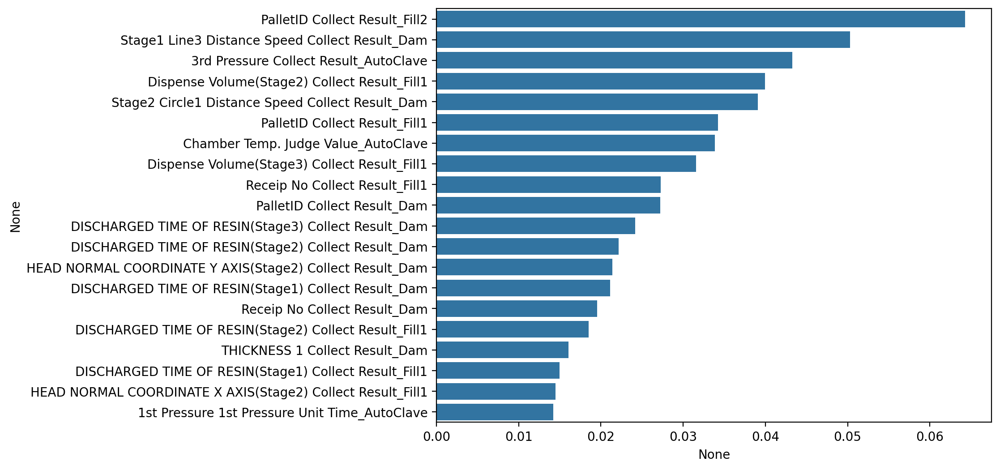

In [126]:
import matplotlib.pyplot as plt # 득점모델 변수 중요도 xgboost
import seaborn as sns
%matplotlib inline
 
ftr_importances_values = model.feature_importances_
ftr_importances = pd.Series(ftr_importances_values, index=X.columns)
ftr_top = ftr_importances.sort_values(ascending=False)[:20]
 
plt.figure(figsize=(8, 6))
sns.barplot(x=ftr_top, y=ftr_top.index)
plt.show()

In [127]:
# ftr_importances 시리즈를 내림차순으로 정렬
sorted_importances = ftr_importances.sort_values(ascending=False)

# DataFrame 생성 및 열 이름과 인덱스 이름 설정
df_importances = pd.DataFrame(sorted_importances, columns=["importance"])
df_importances.index.name = "col_name"

In [128]:
df_importances.reset_index(inplace = True)

In [129]:
importance_col = df_importances[:30]['col_name'].tolist()

In [130]:
test_pred = model.predict_proba(x_test)[:, 1]

In [131]:
test_pred1 = test_pred

new_pred = np.where(test_pred1 > 0.5, 1, 0)

In [132]:
# 제출 데이터 읽어오기 (df_test는 전처리된 데이터가 저장됨)
df_sub = pd.read_csv("submission.csv")
df_sub["target"] = new_pred

In [133]:
print(np.bincount(df_sub.loc[index1, 'target']))
print(np.bincount(df_sub.loc[index2, 'target']))
print(np.bincount(df_sub.loc[index3, 'target']))

[ 8 20]
[53]
[20]


In [134]:
df_sub.loc[index1, 'target']

64       1
562      1
1460     1
1530     1
1892     0
2505     1
2710     1
3457     1
3682     0
3732     1
4928     0
4932     0
6092     1
7001     0
7287     1
7666     1
7836     0
8253     1
8898     1
10989    1
12439    1
12585    1
12844    1
14756    1
15180    1
15406    0
15811    0
15964    1
Name: target, dtype: int64

In [135]:
# 특정 인덱스에 대해 'target' 값을 설정
df_sub.loc[index1, 'target'] = 1
df_sub.loc[index2, 'target'] = 0
df_sub.loc[index3, 'target'] = 0
# 역매핑 정의
reverse_mapping = {0: 'Normal', 1: 'AbNormal'}

# 타겟 컬럼을 원래 값으로 되돌리기
df_sub['target'] = df_sub['target'].map(reverse_mapping)

# 제출 파일 저장
df_sub.to_csv("submission.csv", index=False)

In [136]:
df_sub['target'].value_counts()

target
Normal      16863
AbNormal      498
Name: count, dtype: int64

In [66]:
df_sub

,Set ID,target
0,0001be084fbc4aaa9d921f39e595961b,Normal
1,0005bbd180064abd99e63f9ed3e1ac80,Normal
2,000948934c4140d883d670adcb609584,Normal
3,000a6bfd02874c6296dc7b2e9c5678a7,Normal
4,0018e78ce91343678716e2ea27a51c95,Normal
...,...,...
17356,ffea508b59934d689b540f95eb3fa730,Normal
17357,ffed8923c8a448a98afc641b770be153,Normal
17358,fff1e73734da40adbe805359b3efb462,Normal
17359,fff8e38bdd09470baf95f71e92075dec,Normal


## K-fold

In [167]:
from sklearn.model_selection import KFold, StratifiedKFold
from imblearn.over_sampling import BorderlineSMOTE

import xgboost as xgb
from xgboost import XGBClassifier

X_train, y_train = BorderlineSMOTE(random_state=42).fit_resample(X, y)
    

kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=37)

model_k  = XGBClassifier(random_state = 42, learning_rate =0.1, n_estimators=200,
    max_depth=9, subsample=0.8,colsample_bytree=0.8,scale_pos_weight = 5)

#model_k = XGBClassifier(random_state =42, **xgb_params)

score_f1 = []


for trn_idx, val_idx in kfold.split(X_train, y_train):
    
    X_trn, y_trn = X_train.iloc[trn_idx, :], y_train.iloc[trn_idx]
    X_val, y_val = X_train.iloc[val_idx, :], y_train.iloc[val_idx]
    
    model_k.fit(X_trn, y_trn)
    
    y_pred = model_k.predict(X_val)
    
    print('예측 완료')
    
    score_f1.append(f1_score(y_val, y_pred))

mean_score = sum(score_f1) / len(score_f1)
print(mean_score)

예측 완료
예측 완료
예측 완료
예측 완료
예측 완료
예측 완료
예측 완료
예측 완료
예측 완료
예측 완료
0.9667531157360066


In [168]:
result = []

kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=37)

for trn_idx, val_idx in kfold.split(X_train, y_train):
    
    X_trn, y_trn = X_train.iloc[trn_idx, :], y_train.iloc[trn_idx]
    X_val, y_val = X_train.iloc[val_idx, :], y_train.iloc[val_idx]
    
    model_k.fit(X_trn, y_trn)
    
    y_pred = model_k.predict_proba(x_test)[:, 1]
    
    result.append(y_pred)

In [169]:
# 5개 결과의 평균 구하기
average_result = np.mean(result, axis=0)
average_result

array([0.17355627, 0.03782267, 0.18518378, ..., 0.13959952, 0.06031906,
       0.0760714 ], dtype=float32)

In [170]:
test_pred1 = average_result

new_pred = np.where(test_pred1 > 0.5, 1, 0)

# 제출 데이터 읽어오기 (df_test는 전처리된 데이터가 저장됨)
df_sub = pd.read_csv("submission.csv")
df_sub["target"] = new_pred
print(np.bincount(df_sub.loc[index1, 'target']))
print(np.bincount(df_sub.loc[index2, 'target']))
print(np.bincount(df_sub.loc[index3, 'target']))

[ 8 20]
[50  3]
[20]


In [171]:
df_sub.loc[index1, 'target']

64       1
562      1
1460     1
1530     1
1892     0
2505     1
2710     1
3457     1
3682     1
3732     1
4928     0
4932     0
6092     0
7001     0
7287     0
7666     1
7836     1
8253     1
8898     1
10989    1
12439    1
12585    1
12844    1
14756    1
15180    1
15406    0
15811    0
15964    1
Name: target, dtype: int64

In [172]:
df_sub.loc[index1, 'target'] = 1
df_sub.loc[index2, 'target'] = 0
df_sub.loc[index3, 'target'] = 0

# 역매핑 정의
reverse_mapping = {0: 'Normal', 1: 'AbNormal'}

# 타겟 컬럼을 원래 값으로 되돌리기
df_sub['target'] = df_sub['target'].map(reverse_mapping)

# 제출 파일 저장
df_sub.to_csv("submission.csv", index=False)

In [173]:
df_sub['target'].value_counts()

target
Normal      16953
AbNormal      408
Name: count, dtype: int64